# Задача 

Сравнение трехмерного пространства автокодировщика, вариационного авткодировщика и сиамской нейронной сети для решения задач многомерной классификациии кластеризации данных.

# Решение

## Среда

In [24]:
#@title Библиотеки
import os
import sys
import random as random
import matplotlib.pyplot as plt 
import matplotlib.image as matimg
import seaborn as sns
sns.set_style('darkgrid')
import numpy as np
from IPython.display import clear_output, Image as ImagePy 
from PIL import Image 
import imageio 
import time
import datetime
#from google.colab import drive # подключаем гугл драйв диск для загрузки файлов
#drive.mount('/content/drive')

import tensorflow as tf
from tensorflow import keras
from keras import backend as K
from tensorflow.keras.models import *
from tensorflow.keras import layers
from tensorflow.keras.layers import *
from tensorflow.keras.callbacks import *
from tensorflow.keras.preprocessing import image # для отрисовки изображения
from tensorflow.keras.optimizers import Adam # загружаем выбранный оптимизатор
from tensorflow.keras import utils # загружаем утилиты кераса
from tensorflow.keras.regularizers import * # Регуляризаторы

In [25]:
#@title Параметры
DATA_PATH = os.path.join('data', 'compare')
SHAPE_IN = (28, 28, 1)
EPS = 50

## Датасет

In [76]:
#@title Загрузка
(train_images, train_class), (test_images, test_class) = tf.keras.datasets.mnist.load_data()

In [77]:
#@title Нормализация
def preprocess_images(images):
  images = images.reshape((images.shape[0], 28, 28, 1)) / 255.
  return np.where(images > .5, 1.0, 0.0).astype('float32')

train_images = preprocess_images(train_images)
test_images = preprocess_images(test_images)

In [113]:
#@title Выборки автокодировщика
train_ae = test_images[(test_class != 0) & (test_class != 1)]
train_aelbl = test_class[(test_class != 0) & (test_class != 1)]
test_ae = test_images[(test_class == 0) | (test_class == 1)]
test_aelbl = test_class[(test_class == 0) | (test_class == 1)]
train_ae.shape, test_ae.shape

((7885, 28, 28, 1), (2115, 28, 28, 1))

In [114]:
#@title Выборки сиамской сети
train_siam_a, train_siam_b = [],[]
train_siam_y = []
for i in range(train_ae.shape[0]):
  a = random.randint(0, train_ae.shape[0]-1)
  b = random.randint(0, train_ae.shape[0]-1)
  train_siam_a.append(train_ae[a])
  train_siam_b.append(train_ae[b])
  train_siam_y.append(float(train_aelbl[a] == train_aelbl[b]))
train_siam_y = np.array(train_siam_y)
train_siam_a = np.array(train_siam_a)
train_siam_b = np.array(train_siam_b)

test_siam_a, test_siam_b = [],[]
test_siam_y = []
for i in range(test_ae.shape[0]):
  a = random.randint(0, test_ae.shape[0]-1)
  b = random.randint(0, test_ae.shape[0]-1)
  test_siam_a.append(test_ae[a])
  test_siam_b.append(test_ae[b])
  test_siam_y.append(float(test_aelbl[a] == test_aelbl[b]))
test_siam_y = np.array(test_siam_y)
test_siam_a = np.array(test_siam_a)
test_siam_b = np.array(test_siam_b)

train_siam_a.shape, train_siam_y.shape, test_siam_a.shape, test_siam_y.shape


((7885, 28, 28, 1), (7885,), (2115, 28, 28, 1), (2115,))

## Модели

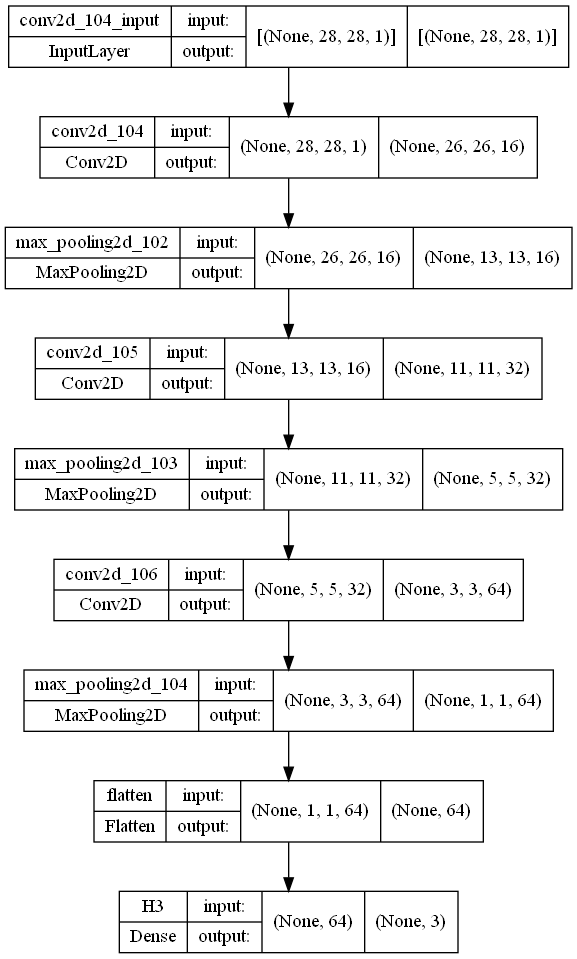

In [84]:
#@title Encoder
def get_encoder(act='relu', dim=3, s=1):  
  return Sequential([
     Conv2D(16,  (3, 3), activation=act, input_shape=SHAPE_IN, strides=s),                
     MaxPooling2D(),
     Conv2D(32,  (3, 3), activation=act, strides=s),
     MaxPooling2D(),
     Conv2D(64,  (3, 3), activation=act, strides=s),
     MaxPooling2D(),
     Flatten(name='flatten'), 
     Dense(dim, name='H3'),                    
    ], name='encoder')
utils.plot_model(get_encoder(), dpi=96, show_shapes=True)

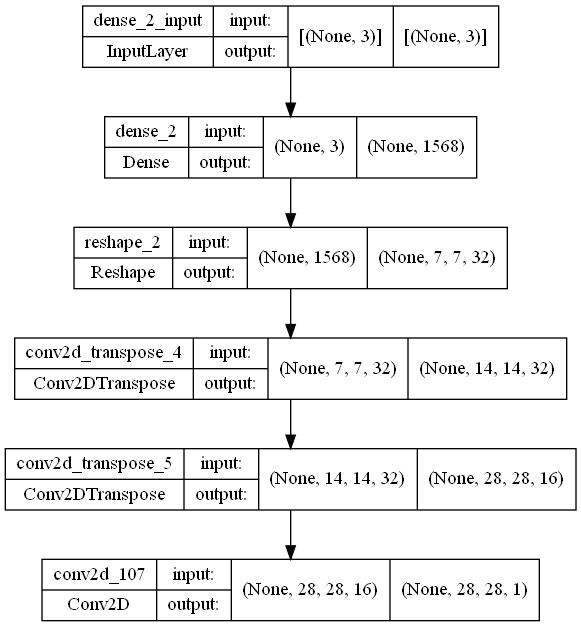

In [85]:
#@title Decoder
def get_decoder(act='relu', dim=3, chs=1):
    return Sequential([
     Dense(7 * 7 * 32, activation=act,  input_dim=dim),
     Reshape((7, 7, 32)),
     Conv2DTranspose(32,   (3, 3), activation=act, strides=2, padding='same'),
     Conv2DTranspose(16,   (3, 3), activation=act, strides=2, padding='same'),
     Conv2D(chs, (3, 3), activation='sigmoid', padding='same'), # kernel_regularizer = l1(5e-4)          
    ], name='decoder')
utils.plot_model(get_decoder(), dpi=96, show_shapes=True)

Model: "Autoencoder_dim3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image (InputLayer)          [(None, 28, 28, 1)]       0         
                                                                 
 encoder (Sequential)        (None, 3)                 23491     
                                                                 
 decoder (Sequential)        (None, 28, 28, 1)         20289     
                                                                 
Total params: 43,780
Trainable params: 43,780
Non-trainable params: 0
_________________________________________________________________
None


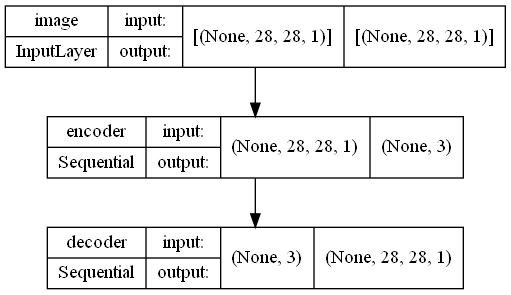

In [86]:
#@title Автокодировщик
def get_ae(act='relu', dim=3):
  encoder = get_encoder(act, dim=dim)
  decoder = get_decoder(act, dim=dim)
  
  x  = Input(shape=SHAPE_IN, name='image')

  y  = encoder(x) 
  y  = decoder(y)
   
  ae = Model(x, y, name=f"Autoencoder_dim{dim}")
  ae.compile(optimizer="Adam", loss='mse')
  
  return ae, encoder, decoder

model, encoder, decoder = get_ae()
print(model.summary())
utils.plot_model(model, dpi=96, show_shapes=True)

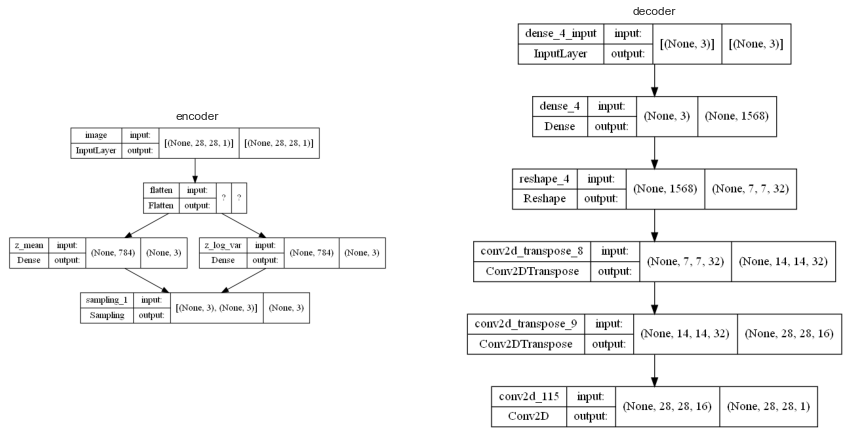

In [87]:
#@title Вариационный автокодировщик
class Sampling(layers.Layer):
    """Uses (z_mean, z_log_var) to sample z, the vector encoding a digit."""

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch   = tf.shape(z_mean)[0]
        dim     = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon

class VAE(keras.Model):
    def __init__(self, encoder, decoder, **kwargs):
        super(VAE, self).__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder
        self.total_loss_tracker = keras.metrics.Mean(name="total_loss")
        self.reconstruction_loss_tracker = keras.metrics.Mean(
            name="reconstruction_loss"
        )
        self.kl_loss_tracker = keras.metrics.Mean(name="kl_loss")
    
    def summary(self):
      return self.encoder.summary(), self.decoder.summary() 
    
    def plot_model(self):
        # Выводим схему модели
        plt.figure(figsize=(15,15))
        for i, model in enumerate((self.encoder, self.decoder)):
          fname = os.path.join(DATA_PATH, 'model.png')
          utils.plot_model(model, dpi=96, show_shapes=True, to_file=fname) 
          plt.subplot(121 + i)
          plt.title(model.name)
          plt.imshow(matimg.imread(fname)) 
          plt.axis('off')
        plt.show()

    @property
    def metrics(self):
        return [
            self.total_loss_tracker,
            self.reconstruction_loss_tracker,
            self.kl_loss_tracker,
        ]

    def train_step(self, data):
        with tf.GradientTape() as tape:
            z_mean, z_log_var, z = self.encoder(data)
            reconstruction = self.decoder(z)
            reconstruction_loss = tf.reduce_mean(
                tf.reduce_sum(
                    keras.losses.binary_crossentropy(data, reconstruction), axis=(1, 2)
                )
            )
            kl_loss = -0.5 * (1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var))
            kl_loss = tf.reduce_mean(tf.reduce_sum(kl_loss, axis=1))
            total_loss = reconstruction_loss + kl_loss
        grads = tape.gradient(total_loss, self.trainable_weights)
        self.optimizer.apply_gradients(zip(grads, self.trainable_weights))
        self.total_loss_tracker.update_state(total_loss)
        self.reconstruction_loss_tracker.update_state(reconstruction_loss)
        self.kl_loss_tracker.update_state(kl_loss)
        return {
            "loss": self.total_loss_tracker.result(),
            "reconstruction_loss": self.reconstruction_loss_tracker.result(),
            "kl_loss": self.kl_loss_tracker.result(),
        }
def get_vae(act='relu', dim=3):

  encoder = get_encoder(act=act, dim=dim)
  decoder = get_decoder(act=act, dim=dim)
  
  x  = Input(shape=SHAPE_IN, name='image')

  y = encoder.get_layer('flatten')(x)
  
  # mu sigma
  z_mean    = Dense(dim, name="z_mean")(y)
  z_log_var = Dense(dim, name="z_log_var")(y)
  z = Sampling()([z_mean, z_log_var])
  y = [z_mean, z_log_var, z]

  enc = Model(x, y, name='encoder')

  vae = VAE(enc, decoder)
  vae.compile(optimizer="Adam")
  return vae

get_vae().plot_model()

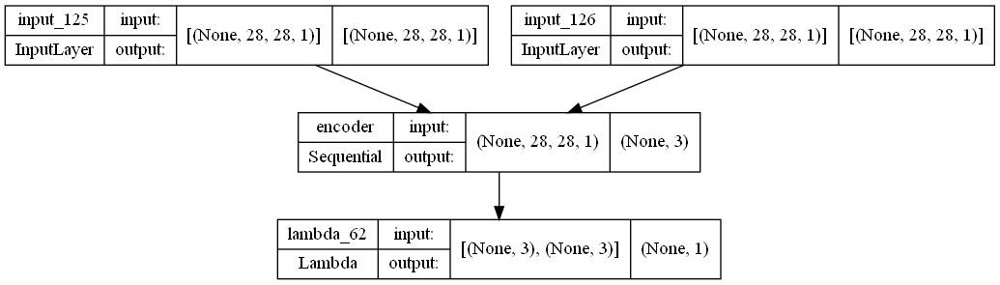

In [143]:
#@title Сиамская нейронная сеть

def get_siam(act='relu', dim=3, habr=False):

  img_a = Input(shape=SHAPE_IN)
  img_b = Input(shape=SHAPE_IN)

  encoder = get_encoder(act=act, dim=dim)

  vecs_a = encoder(img_a)
  vecs_b = encoder(img_b)
  
  def euclidean_distance_exp(vects):
    x, y = vects
    dist = K.sqrt(K.sum(K.square(x - y), axis=1, keepdims=True))
    if habr: return dist
    return K.exp(-K.sqrt(dist))

  def eucl_dist_output_shape(shapes):
    shape1, shape2 = shapes
    return (shape1[0], 1)

  distance = Lambda(euclidean_distance_exp, 
                    output_shape=eucl_dist_output_shape)([vecs_a, vecs_b])

  
  model = Model([img_a, img_b], distance)

  if not habr:
      model.compile(optimizer="Adam", loss='binary_crossentropy')
      return model, encoder

  def loss_siam(distance):
      def contrastive_loss(y_true, y_pred):
        margin = 1.
        loss = K.mean(y_true * K.square(y_pred) + (1 - y_true) * K.square(K.maximum(margin - y_pred, 0)))
        return loss
      return contrastive_loss
    
    
  model.compile(optimizer="Adam", loss=loss_siam(distance))
    
    
  return model, encoder

utils.plot_model(get_siam()[0], dpi=96, show_shapes=True)

## Обучение

In [89]:
#@title График обучения
def show_loss(fname, title=''):
    sns.set_style('darkgrid')
    plt.figure(figsize=(12,8))
    loss, x, lr = [], [], 0.001
    with open(fname, 'r') as f:
      for v in f:
        logs = v.split(',')
        loss.append(float(logs[1]))
        if lr - float(logs[2]) != 0:
            x.append(int(logs[0]))
    plt.title(f'График ошибки '+title)
    plt.plot(loss)
    plt.xlabel('Эпоха')
    y = [loss[i] for i in x]
    plt.scatter(x, y, label='Увеличение скорости', c='red')
    plt.legend()
    plt.show()

In [90]:
#@title Колбэк

class SpaceXYZ(Callback):

      def on_epoch_begin(self, epoch, logs): 
        self.e = epoch
        self.show_space()
        
      def on_epoch_end(self, epoch, logs):
        self.loss = logs['loss']
        logs['lr']=self.model.optimizer.learning_rate.numpy()
        with open(self.floss, 'a') as f:
              f.write(f'{epoch},%(loss)s,%(lr)s\n' % logs) 

      
      def on_train_end(self, logs=None):
        self.e += 1
        self.show_space()
        self.save_gif()
        self.model.save_weights(DATA_PATH + os.path.sep + f'{self.name}_end.hdf5')

      def show_space(self):
        loss =  f'\n{self.loss:.4f}' if hasattr(self, 'loss') else ''
        fig = plt.figure(figsize=(15, 15))
        ax = fig.add_subplot(111, projection='3d')
        plt.title(f'Эпоха №{self.e}{loss}')
        scatter = {}
        for x, y in zip(self.pred(self.x), self.y):
            if scatter.get(y) is None: scatter[y] = ([],[],[])
            scatter[y][0].append(x[0])
            scatter[y][1].append(x[1])
            scatter[y][2].append(x[2])

        for y, x in scatter.items():
          ax.scatter(*x, label=y)  
        plt.legend()  
        fname = os.path.join(self.dspace, f'img{self.e:03d}.jpg') 
        plt.savefig(fname)
        plt.close()

      def save_gif(self):
        #@title Анимация пространства
        imgs = []
        l = os.listdir(self.dspace)
        for fname in l:
          imgs += [imageio.imread(os.path.join(self.dspace, fname))]
        imageio.mimsave(self.gif, imgs)
       

def call_back (name, pred, x, y):

  space = SpaceXYZ()
  space.floss = os.path.join(DATA_PATH, f'{name}.csv')
  space.dspace = os.path.join(DATA_PATH, name)
  space.gif = os.path.join(DATA_PATH, f'{name}.gif')
  space.pred = pred
  if not os.path.exists(space.dspace):
    os.mkdir(space.dspace)
  if os.path.exists(space.floss):
    os.remove(space.floss)
  space.name = name  
  space.x = x[:100]
  space.y = y[:100]
  return [  space,
            # Динамический lr
            ReduceLROnPlateau(monitor='loss', factor=0.1,# Колбэк дообучения
                              patience=5, min_lr=0.0000000001, verbose=0), 
            # Сохранение лучших весов
            ModelCheckpoint(monitor='loss', 
                            verbose=0, 
                            filepath = f'{name}.hdf5', 
                            save_best_only=True, 
                            save_weights_only=True)
         ]



In [94]:
#@title Автокодировщик
model, encoder, decoder = get_ae()
h = model.fit(train_ae, train_ae, epochs=EPS, 
              callbacks=call_back('ae', encoder.predict, train_ae, train_aelbl))

Epoch 1/50
67/67 [==============================] - 3s 11ms/step - loss: 0.1337 - lr: 0.0010
Epoch 2/50
67/67 [==============================] - 1s 10ms/step - loss: 0.0790 - lr: 0.0010
Epoch 3/50
67/67 [==============================] - 1s 9ms/step - loss: 0.0613 - lr: 0.0010
Epoch 4/50
67/67 [==============================] - 1s 10ms/step - loss: 0.0497 - lr: 0.0010
Epoch 5/50
67/67 [==============================] - 1s 9ms/step - loss: 0.0411 - lr: 0.0010
Epoch 6/50
67/67 [==============================] - 1s 9ms/step - loss: 0.0384 - lr: 0.0010
Epoch 7/50
67/67 [==============================] - 1s 9ms/step - loss: 0.0369 - lr: 0.0010
Epoch 8/50
67/67 [==============================] - 1s 9ms/step - loss: 0.0358 - lr: 0.0010
Epoch 9/50
67/67 [==============================] - 1s 9ms/step - loss: 0.0351 - lr: 0.0010
Epoch 10/50
67/67 [==============================] - 1s 9ms/step - loss: 0.0343 - lr: 0.0010
Epoch 11/50
67/67 [==============================] - 1s 9ms/step - loss: 0.0

In [95]:
#@title VAE
vae = get_vae()
h = vae.fit(train_ae, epochs=EPS, 
              callbacks=call_back('vae', lambda x: vae.encoder.predict(x)[2], 
                                  train_ae, train_aelbl))

Epoch 1/50
67/67 [==============================] - 2s 10ms/step - loss: 469.4855 - reconstruction_loss: 368.5463 - kl_loss: 3.0672 - lr: 0.0010
Epoch 2/50
67/67 [==============================] - 1s 8ms/step - loss: 195.1154 - reconstruction_loss: 176.9142 - kl_loss: 4.7892 - lr: 0.0010
Epoch 3/50
67/67 [==============================] - 1s 8ms/step - loss: 155.9768 - reconstruction_loss: 145.6752 - kl_loss: 4.9823 - lr: 0.0010
Epoch 4/50
67/67 [==============================] - 1s 8ms/step - loss: 130.9279 - reconstruction_loss: 116.9349 - kl_loss: 6.3023 - lr: 0.0010
Epoch 5/50
67/67 [==============================] - 1s 8ms/step - loss: 112.1945 - reconstruction_loss: 103.5822 - kl_loss: 7.0287 - lr: 0.0010
Epoch 6/50
67/67 [==============================] - 1s 8ms/step - loss: 105.0266 - reconstruction_loss: 99.0652 - kl_loss: 7.1225 - lr: 0.0010
Epoch 7/50
67/67 [==============================] - 1s 8ms/step - loss: 104.0521 - reconstruction_loss: 96.8937 - kl_loss: 7.3546 - lr: 

In [120]:
#@title Сиамская сеть
siam, enc = get_siam(habr=True)
h = siam.fit([test_siam_a, test_siam_b], test_siam_y, epochs=EPS, 
              callbacks=call_back('siam_habr', enc.predict, test_ae, test_aelbl))

Epoch 1/50
67/67 [==============================] - 1s 10ms/step - loss: 0.0351 - lr: 0.0010
Epoch 2/50
67/67 [==============================] - 0s 7ms/step - loss: 0.0052 - lr: 0.0010
Epoch 3/50
67/67 [==============================] - 1s 8ms/step - loss: 0.0032 - lr: 0.0010
Epoch 4/50
67/67 [==============================] - 0s 7ms/step - loss: 0.0021 - lr: 0.0010
Epoch 5/50
67/67 [==============================] - 0s 7ms/step - loss: 0.0016 - lr: 0.0010
Epoch 6/50
67/67 [==============================] - 0s 7ms/step - loss: 0.0012 - lr: 0.0010
Epoch 7/50
67/67 [==============================] - 0s 7ms/step - loss: 8.6932e-04 - lr: 0.0010
Epoch 8/50
67/67 [==============================] - 1s 7ms/step - loss: 7.2325e-04 - lr: 0.0010
Epoch 9/50
67/67 [==============================] - 1s 8ms/step - loss: 6.4270e-04 - lr: 0.0010
Epoch 10/50
67/67 [==============================] - 0s 7ms/step - loss: 8.8829e-04 - lr: 0.0010
Epoch 11/50
67/67 [==============================] - 1s 8ms/st

In [144]:
#@title Сиамская сеть
siam, enc = get_siam()
h = siam.fit([test_siam_a, test_siam_b], test_siam_y, epochs=EPS, 
              callbacks=call_back('siam2', enc.predict, test_ae, test_aelbl))

Epoch 1/50
67/67 [==============================] - 1s 10ms/step - loss: 0.3420 - lr: 0.0010
Epoch 2/50
67/67 [==============================] - 1s 8ms/step - loss: 0.2717 - lr: 0.0010
Epoch 3/50
67/67 [==============================] - 1s 8ms/step - loss: 0.2404 - lr: 0.0010
Epoch 4/50
67/67 [==============================] - 1s 8ms/step - loss: 0.2214 - lr: 0.0010
Epoch 5/50
67/67 [==============================] - 1s 8ms/step - loss: 0.2060 - lr: 0.0010
Epoch 6/50
67/67 [==============================] - 1s 8ms/step - loss: 0.1950 - lr: 0.0010
Epoch 7/50
67/67 [==============================] - 1s 8ms/step - loss: 0.1926 - lr: 0.0010
Epoch 8/50
67/67 [==============================] - 1s 8ms/step - loss: 0.1836 - lr: 0.0010
Epoch 9/50
67/67 [==============================] - 1s 8ms/step - loss: 0.1881 - lr: 0.0010
Epoch 10/50
67/67 [==============================] - 1s 8ms/step - loss: 0.1830 - lr: 0.0010
Epoch 11/50
67/67 [==============================] - 1s 8ms/step - loss: 0.168

## Результат

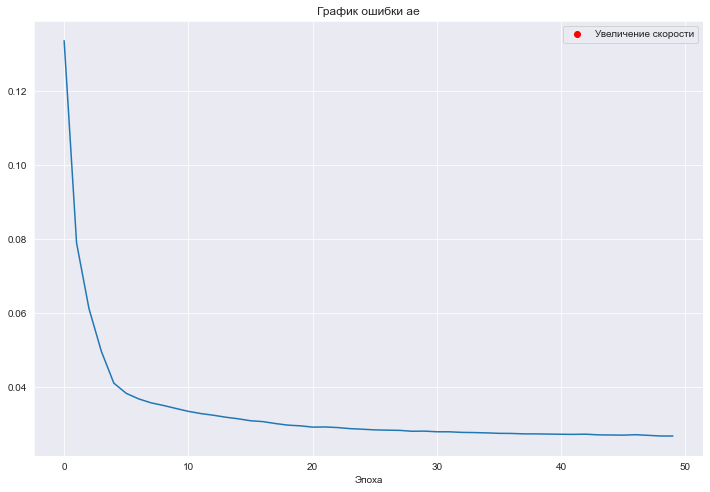

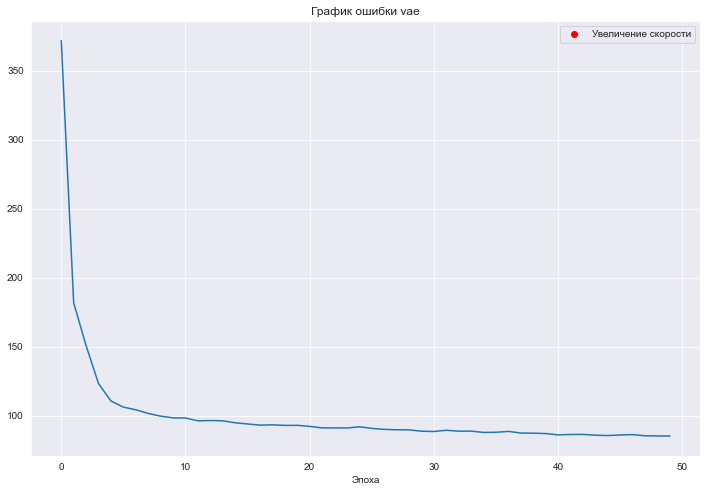

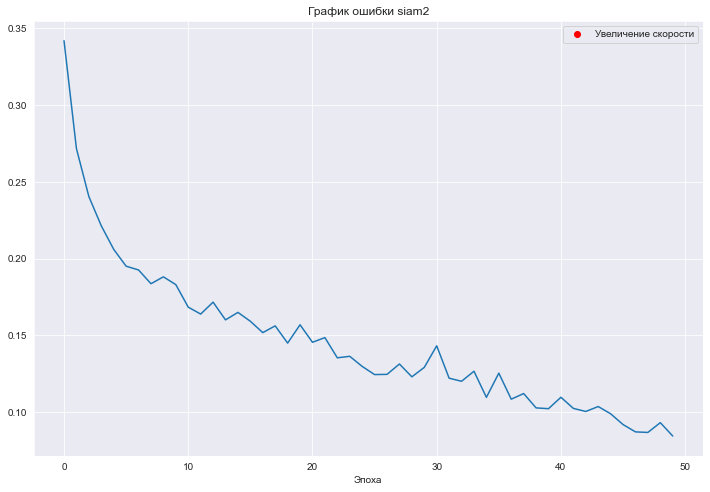

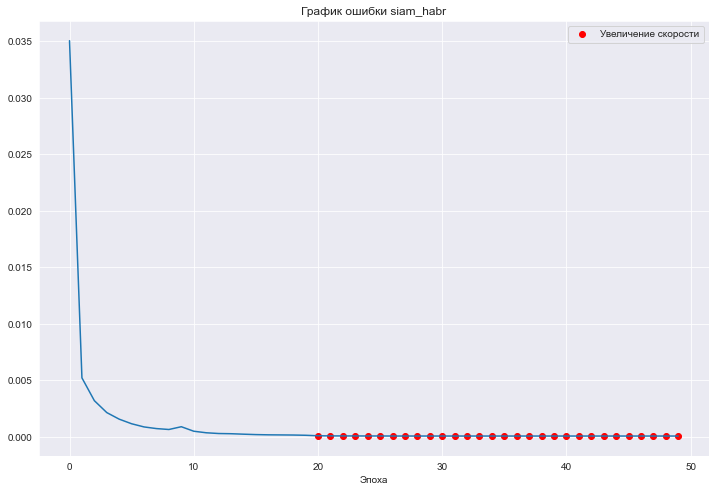

In [145]:
#@title Графики обучения
for name in ('ae', 'vae', 'siam2', 'siam_habr'):
  show_loss(os.path.join(DATA_PATH, f'{name}.csv'), title=name)

ae


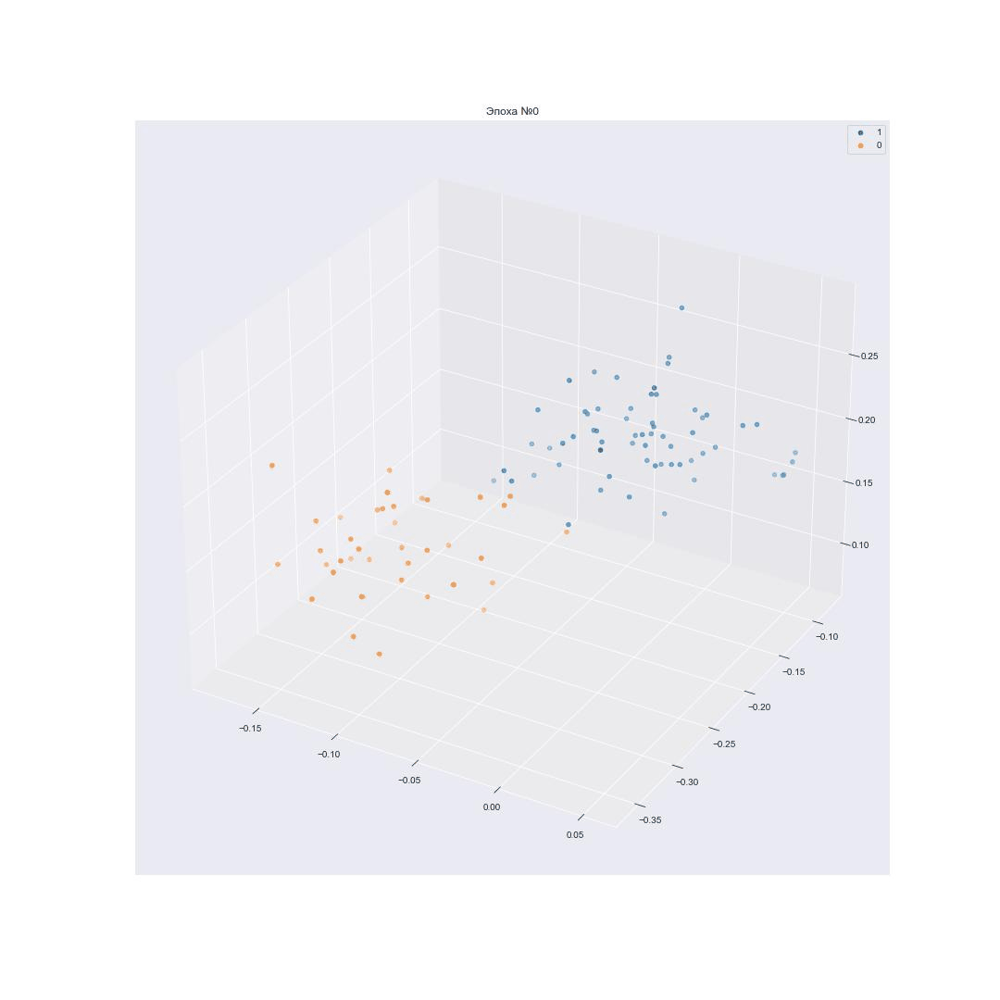

vae


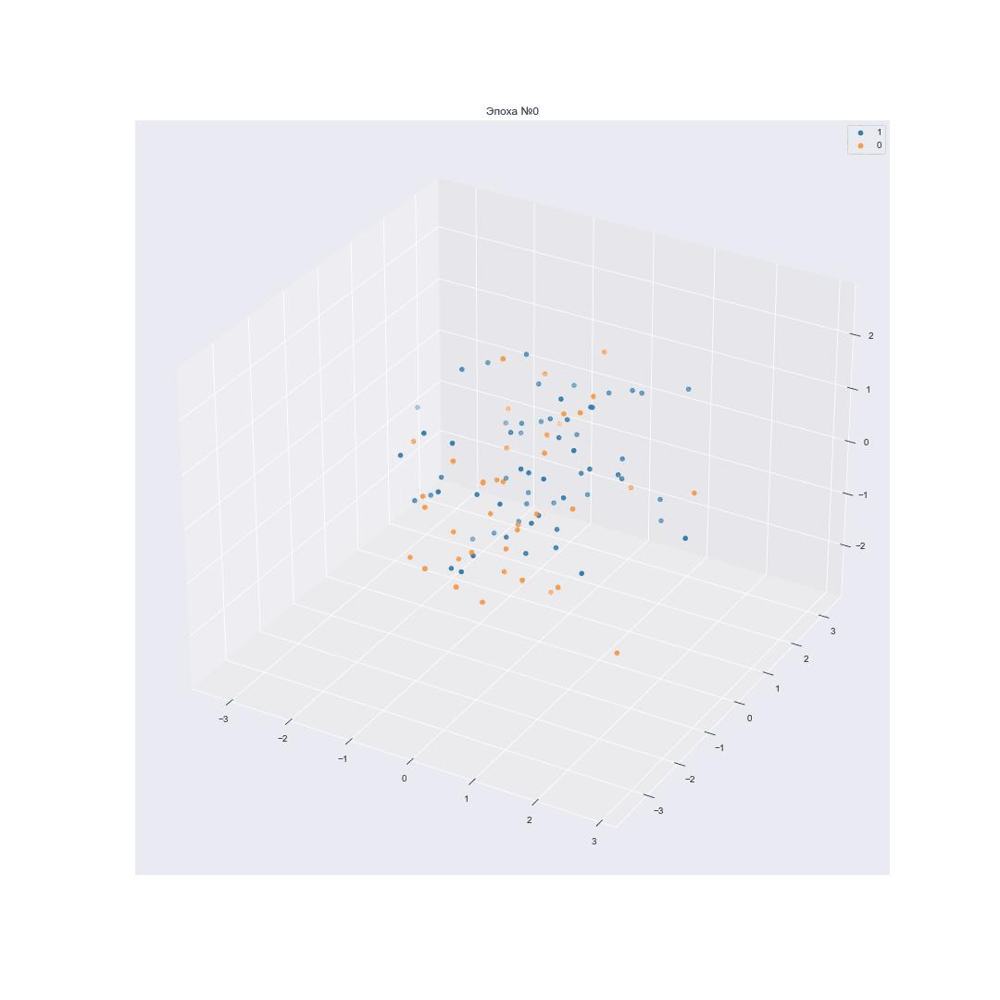

siam2


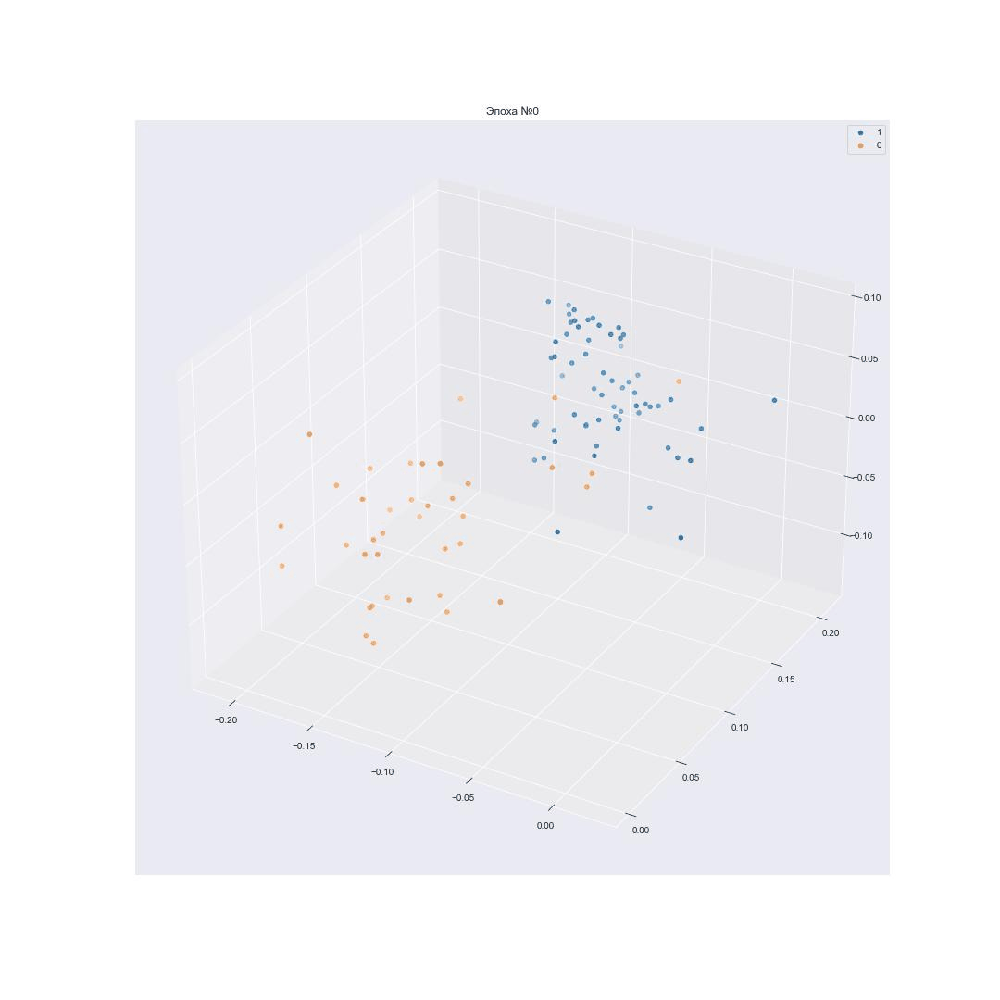

siam_habr


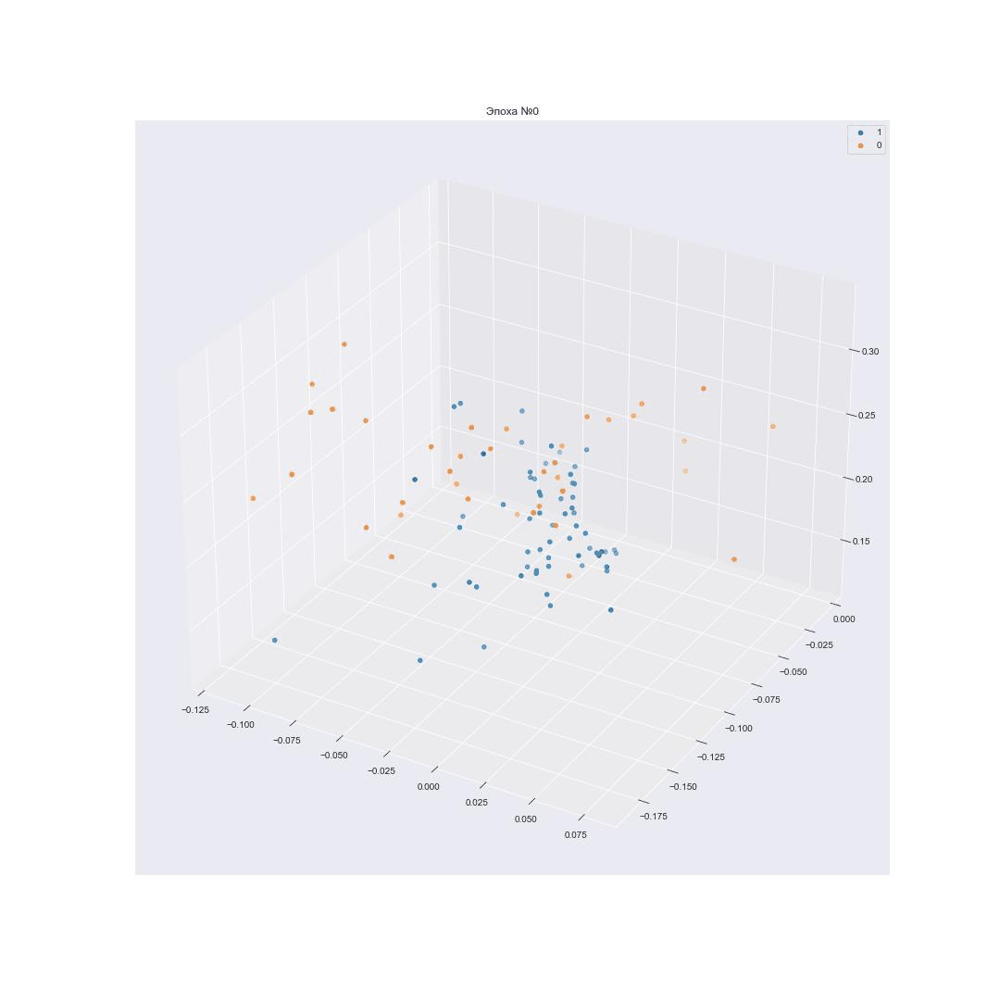

In [146]:
#@title 3D пространство
for name in ('ae', 'vae', 'siam2', 'siam_habr'):
    print(name)
    display(ImagePy(open(os.path.join(DATA_PATH, f'{name}.gif'), 'rb').read(), width=600))

In [147]:
#@title Точность сиамской сети c хабр на новых классах

def acc_siam(siam, a, b, y):
    y = y.ravel()
    pred = siam.predict((a , b)).ravel()
    count_true = 0
    for i in range(len(y)):
        count_true += (y[i] == 1 and pred[i] >= .5) or (y[i] == 0 and pred[i] < .5)
        if len(y) < 10:
            plt.subplot(121)
            plt.title('pred = %s' % pred[i])
            plt.imshow(train_siam_a[i])
            plt.subplot(122)
            plt.imshow(train_siam_b[i])
            plt.title('y = %s' % int(y[i]))
            plt.show()
    return count_true/len(y)

x = 1000
siam, enc = get_siam(habr=True)
siam.load_weights(DATA_PATH + os.path.sep + 'siam_habr_end.hdf5')
acc_siam(siam, train_siam_a[:x], train_siam_b[:x], train_siam_y[:x])


0.658

In [148]:
#@title Точность сиамской сети c бинарной энтропией
siam, enc = get_siam(habr=False)
siam.load_weights(DATA_PATH + os.path.sep + 'siam2_end.hdf5')
acc_siam(siam, train_siam_a[:x], train_siam_b[:x], train_siam_y[:x])

0.826